In [2]:
import ast
import torch

import pandas as pd
import torch.utils.data as torch_data
import numpy as np

import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

BODY_IDENTIFIERS = [
    "nose",
    "neck",
    "rightEye",
    "leftEye",
    "rightEar",
    "leftEar",
    "rightShoulder",
    "leftShoulder",
    "rightElbow",
    "leftElbow",
    "rightWrist",
    "leftWrist"
]

HAND_IDENTIFIERS = [
    "wrist",
    "indexTip",
    "indexDIP",
    "indexPIP",
    "indexMCP",
    "middleTip",
    "middleDIP",
    "middlePIP",
    "middleMCP",
    "ringTip",
    "ringDIP",
    "ringPIP",
    "ringMCP",
    "littleTip",
    "littleDIP",
    "littlePIP",
    "littleMCP",
    "thumbTip",
    "thumbIP",
    "thumbMP",
    "thumbCMC"
]

HAND_IDENTIFIERS = [id + "_0" for id in HAND_IDENTIFIERS] + [id + "_1" for id in HAND_IDENTIFIERS]

def load_dataset(file_location: str, dataframe=None, deployment=False):
    # Load the datset csv file
    if dataframe is not None:
        df = dataframe
    else:
        df = pd.read_csv(file_location, encoding="utf-8")

    # TO BE DELETED
    df.columns = [item.replace("_left_", "_0_").replace("_right_", "_1_") for item in list(df.columns)]
    if "neck_X" not in df.columns:
        df["neck_X"] = [0 for _ in range(df.shape[0])]
        df["neck_Y"] = [0 for _ in range(df.shape[0])]

    # TEMP
    if deployment:
        labels = []
    else:
        labels = df["labels"].to_list()
    # labels = [label + 1 for label in df["labels"].to_list()]
    data = []

    for row_index, row in df.iterrows():
        current_row = np.empty(shape=(len(ast.literal_eval(row["leftEar_X"])), len(BODY_IDENTIFIERS + HAND_IDENTIFIERS), 2))
        for index, identifier in enumerate(BODY_IDENTIFIERS + HAND_IDENTIFIERS):
            current_row[:, index, 0] = ast.literal_eval(row[identifier + "_X"])
            current_row[:, index, 1] = ast.literal_eval(row[identifier + "_Y"])

        data.append(current_row)

    return data, labels

# LSA64

In [3]:
data = load_dataset(r"D:\Spoter_transformer_SLR\datasets\LSA64_60fps.csv")
LSA64_data, LSA64_labels = data

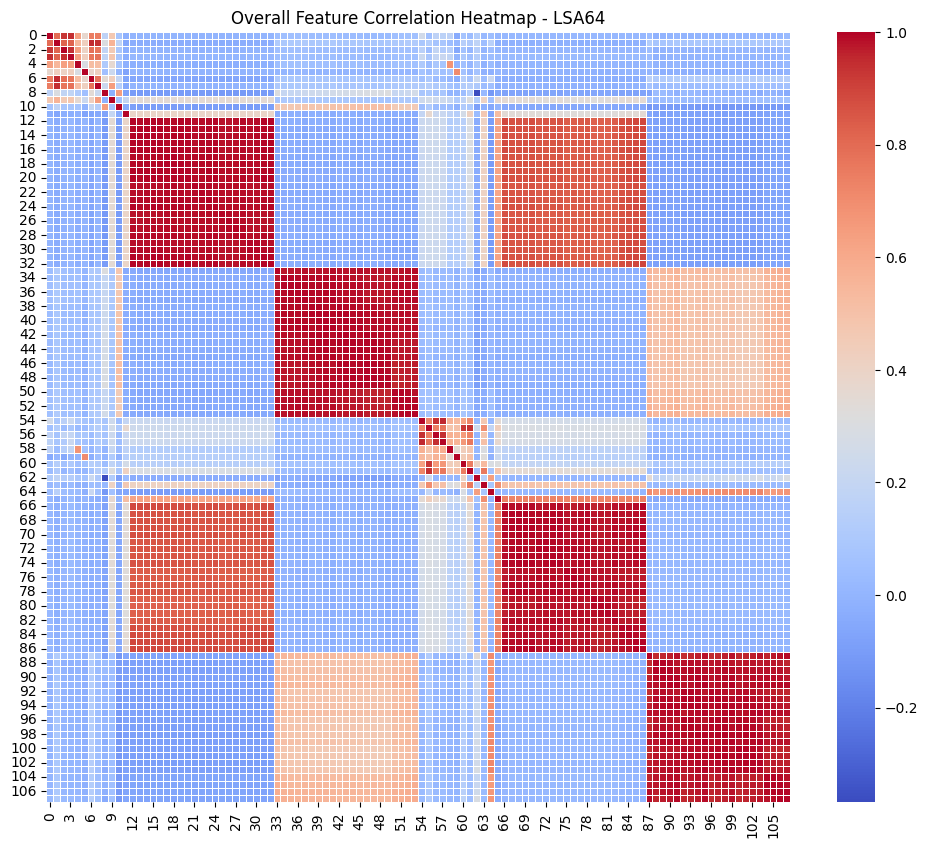

In [7]:
num_keypoints = 54
all_keypoints = np.concatenate([np.array(keypoints).reshape(-1, num_keypoints, 2) for keypoints in LSA64_data])

correlation_matrix = np.corrcoef(all_keypoints[:, :, 0].reshape(-1, num_keypoints).T,
                                  all_keypoints[:, :, 1].reshape(-1, num_keypoints).T)

plt.figure(figsize=(12, 10))
plt.title('Overall Feature Correlation Heatmap - LSA64')
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.show()

D:\Spoter_transformer_SLR\spoter_slr_env\lib\site-packages\numpy\lib\function_base.py:2691: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
D:\Spoter_transformer_SLR\spoter_slr_env\lib\site-packages\numpy\lib\function_base.py:2692: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


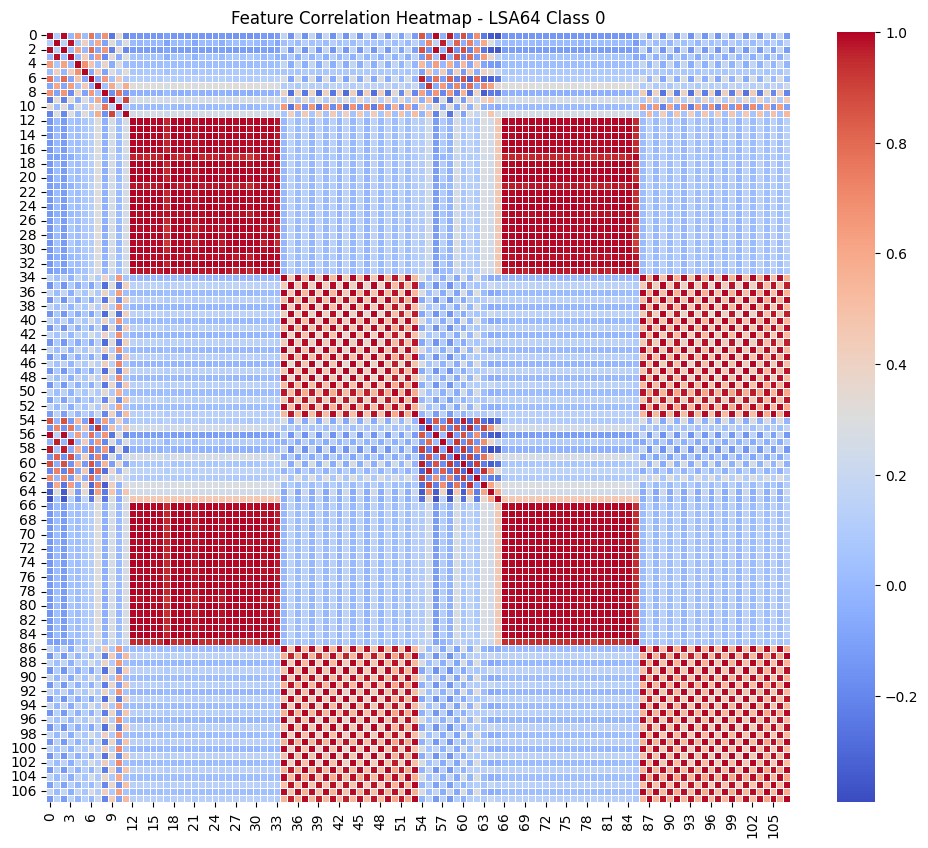

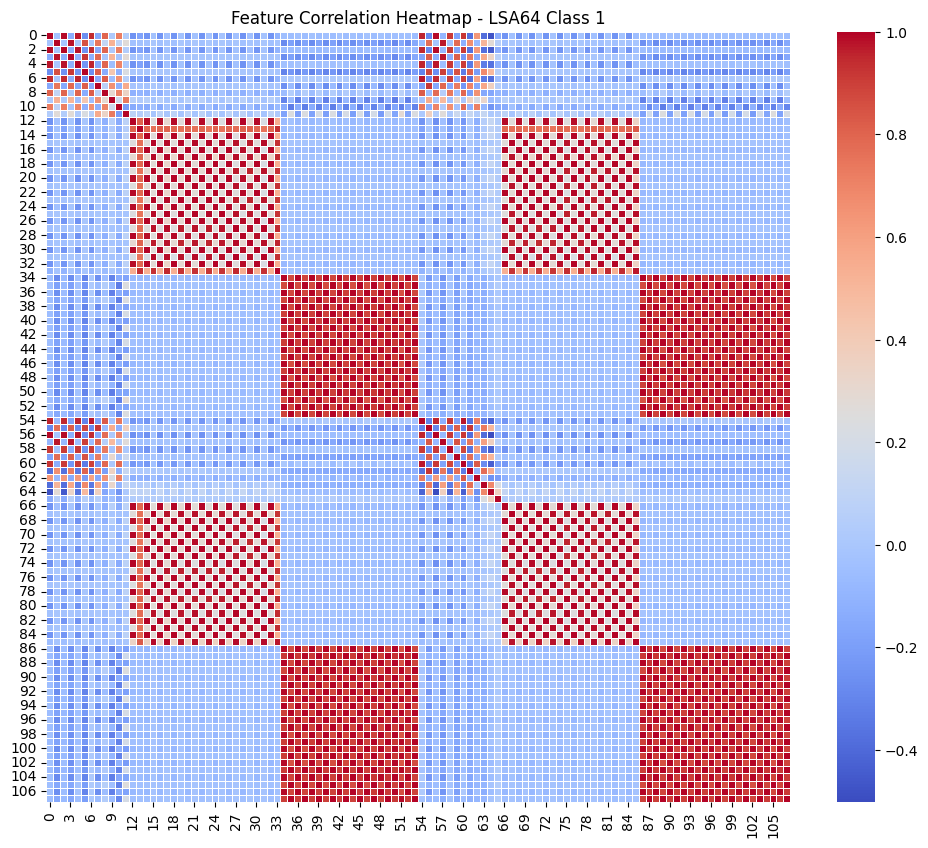

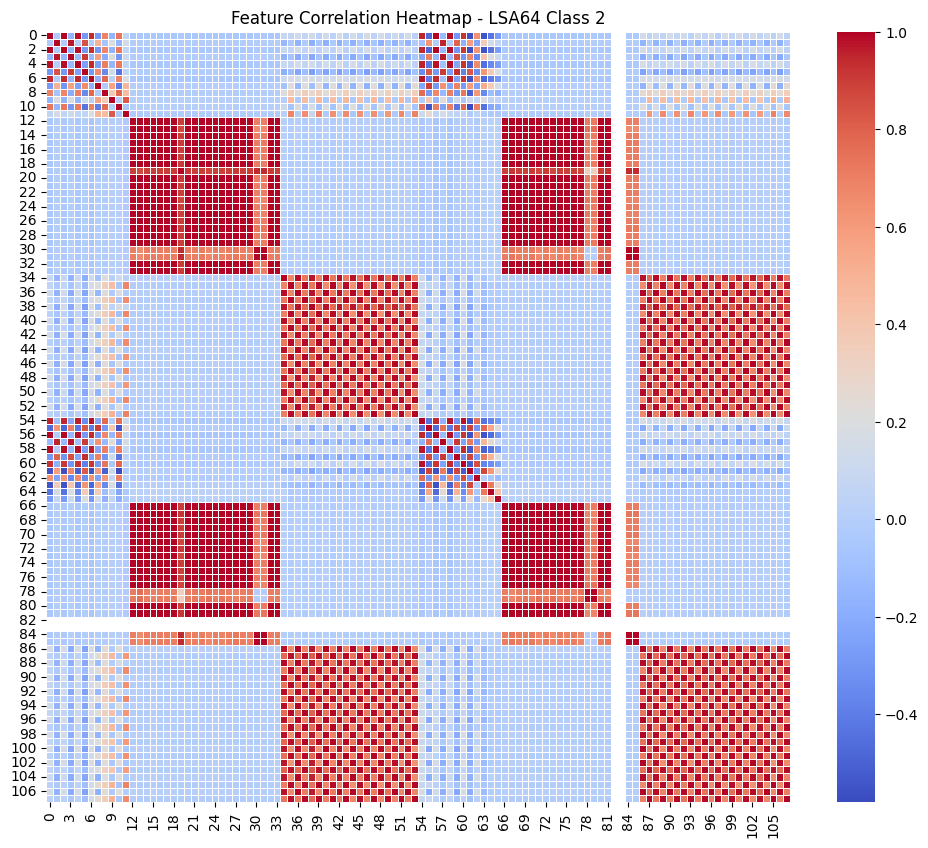

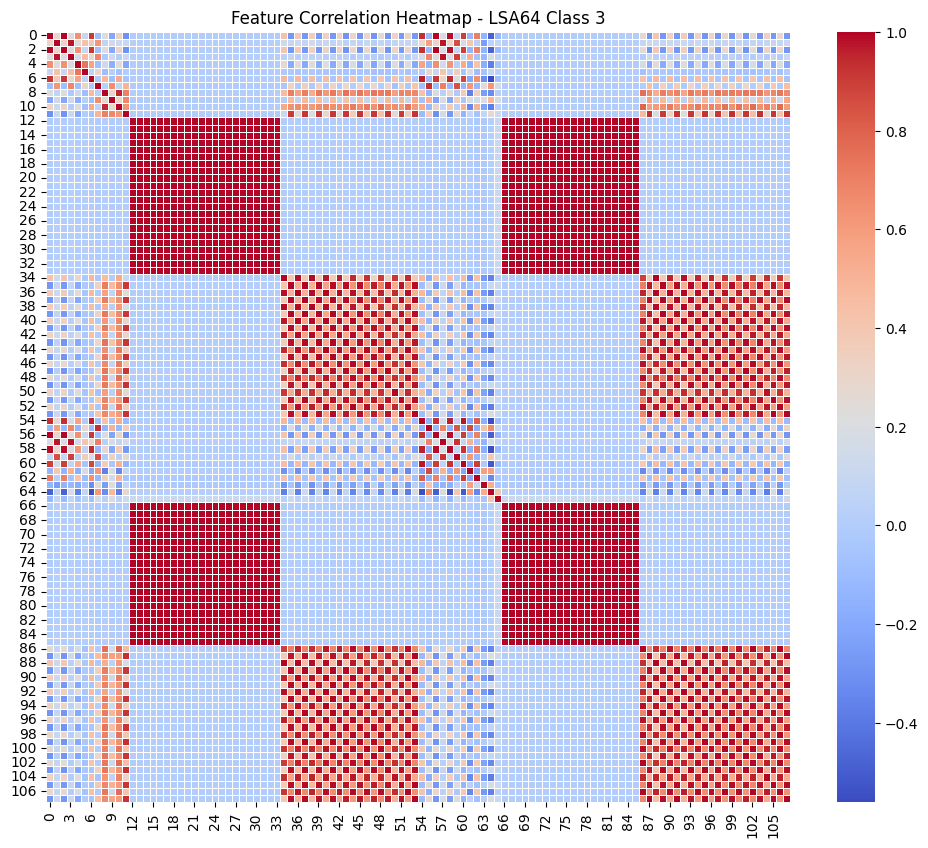

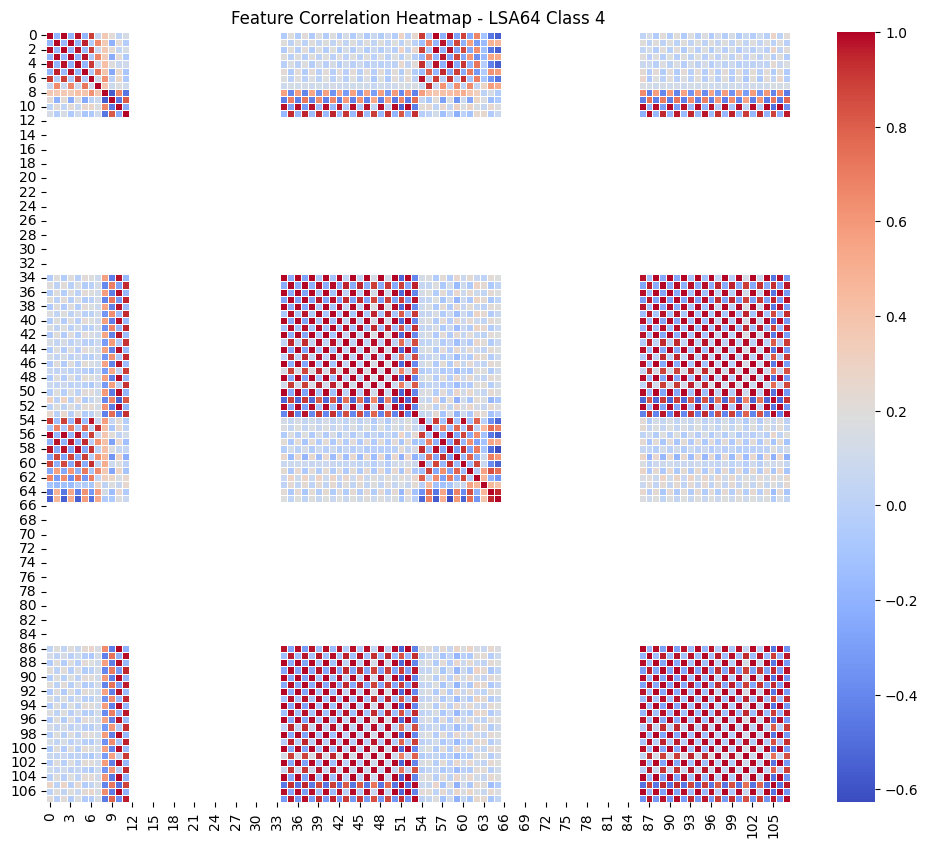

...

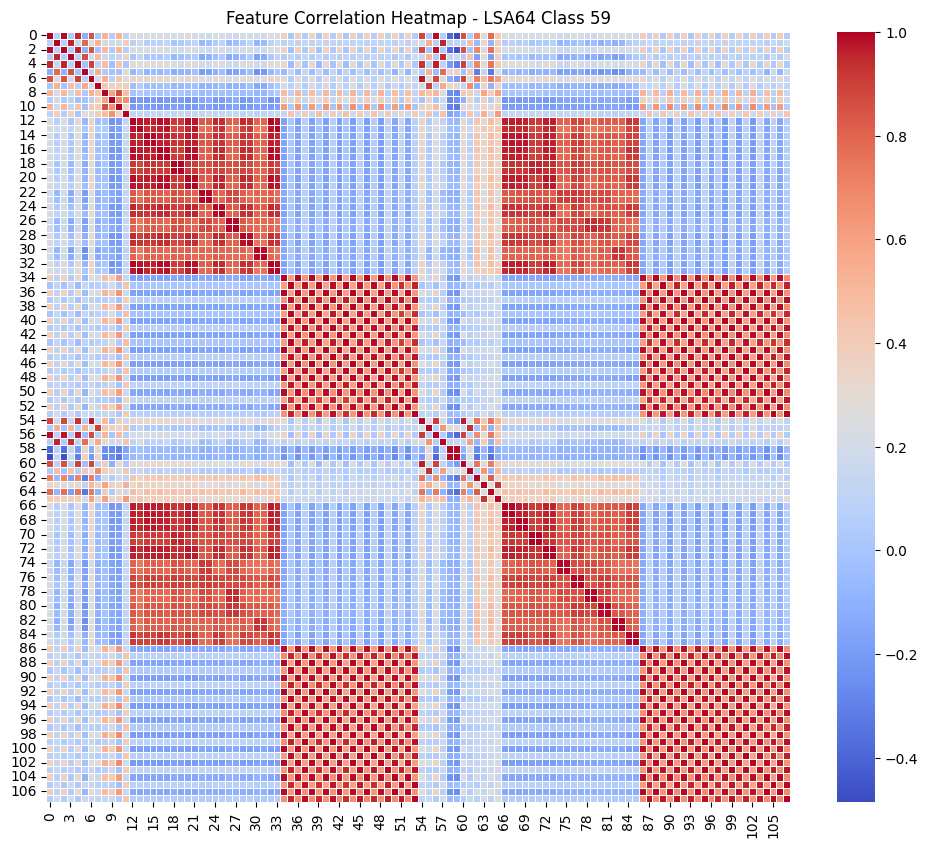

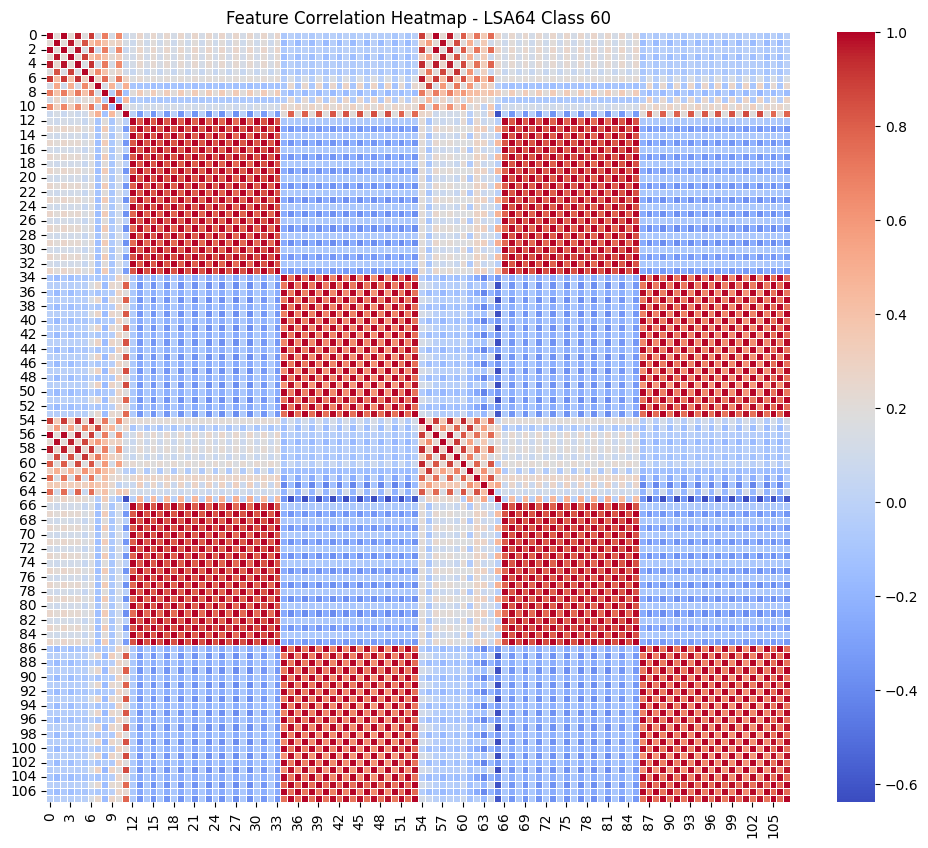

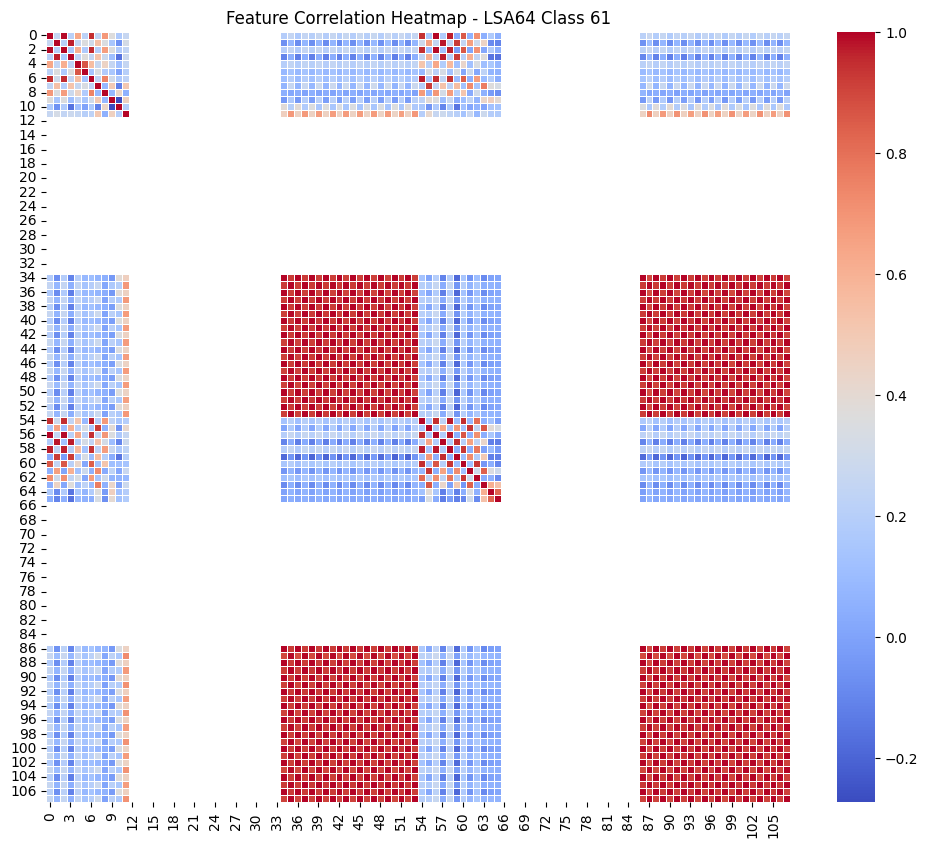

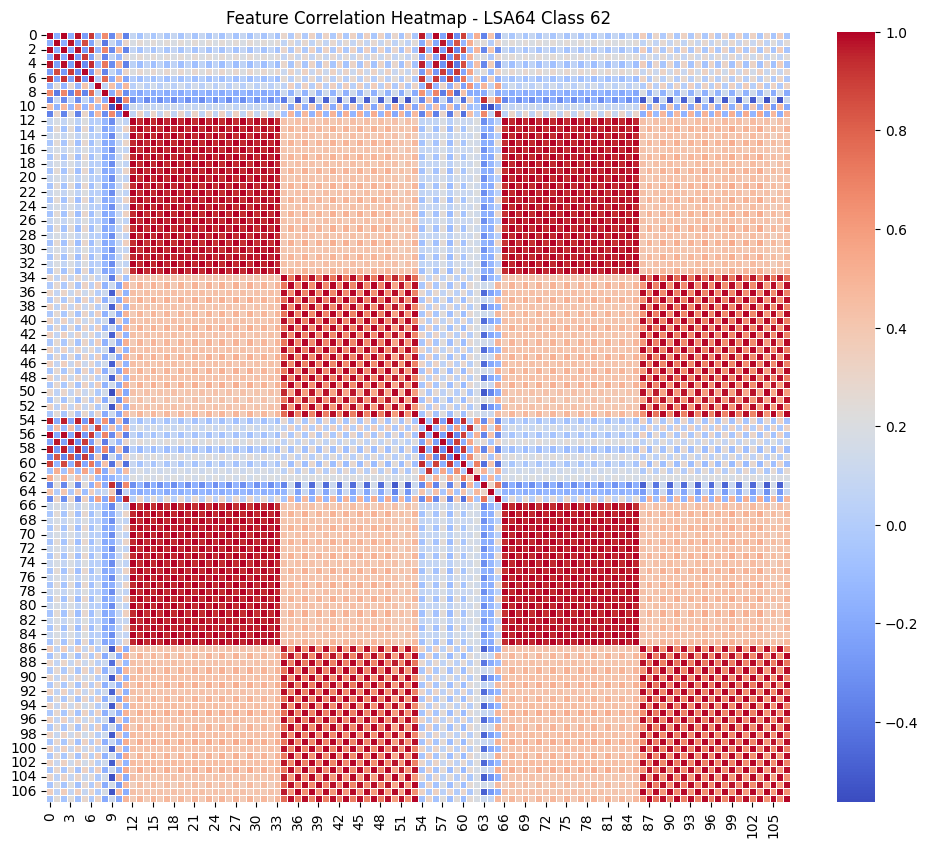

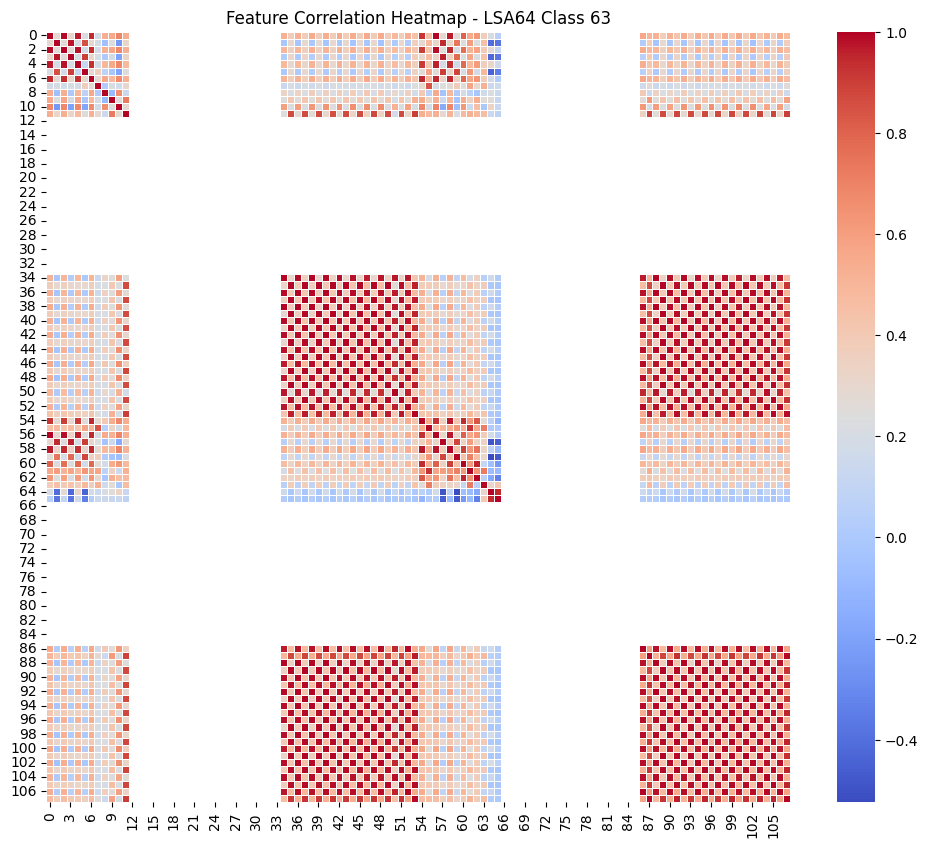

In [6]:
class_keypoints = {label: [] for label in set(LSA64_labels)}

for i in range(len(LSA64_labels)):
    label = LSA64_labels[i]
    keypoints = LSA64_data[i]
    class_keypoints[label].extend(keypoints)  

for label in class_keypoints:
    class_keypoints[label] = np.array(class_keypoints[label])

num_keypoints = 54

correlation_matrices = {label: np.corrcoef(class_keypoints[label][:, 0::2].reshape(-1, num_keypoints).T,
                                           class_keypoints[label][:, 1::2].reshape(-1, num_keypoints).T)
                        for label in class_keypoints}

for label in correlation_matrices:
    plt.figure(figsize=(12, 10))
    plt.title(f'Feature Correlation Heatmap - LSA64 Class {label}')
    sns.heatmap(correlation_matrices[label], annot=False, cmap='coolwarm', fmt=".2f", linewidths=.5)
    plt.show()

# WLASL

In [9]:
data = load_dataset(r"D:\Spoter_transformer_SLR\datasets\WLASL100_train_25fps.csv")
WLASL_Train_data, WLASL_Train_labels = data

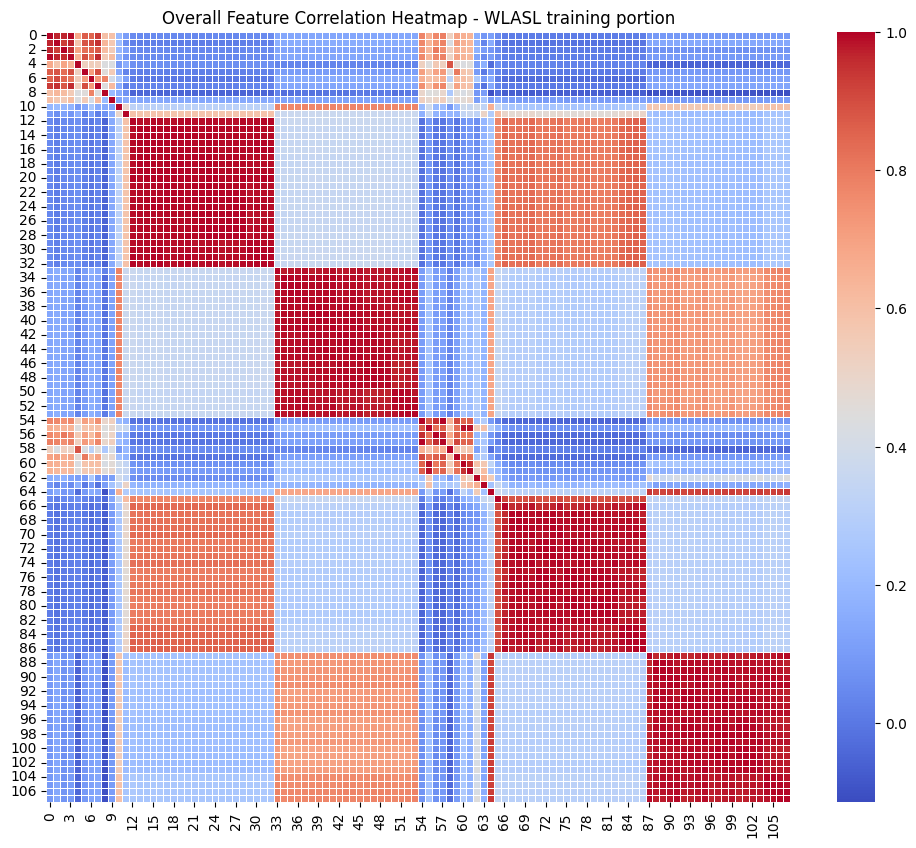

In [10]:
num_keypoints = 54
all_keypoints = np.concatenate([np.array(keypoints).reshape(-1, num_keypoints, 2) for keypoints in WLASL_Train_data])

correlation_matrix = np.corrcoef(all_keypoints[:, :, 0].reshape(-1, num_keypoints).T,
                                  all_keypoints[:, :, 1].reshape(-1, num_keypoints).T)

plt.figure(figsize=(12, 10))
plt.title('Overall Feature Correlation Heatmap - WLASL training portion')
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.show()

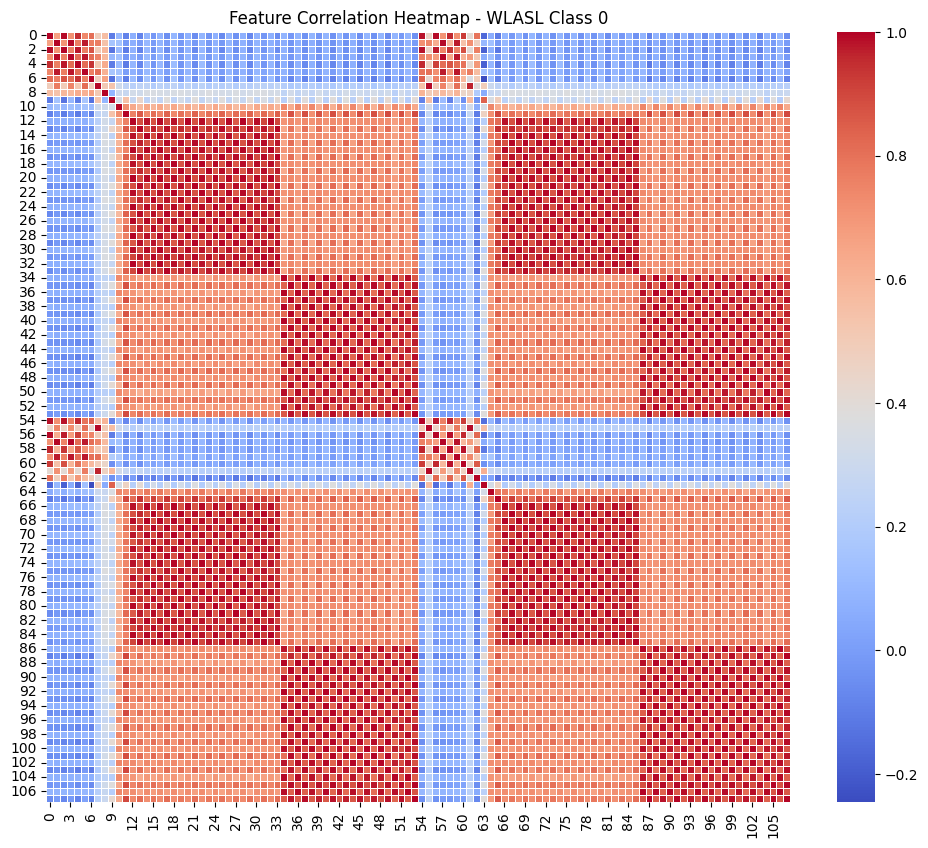

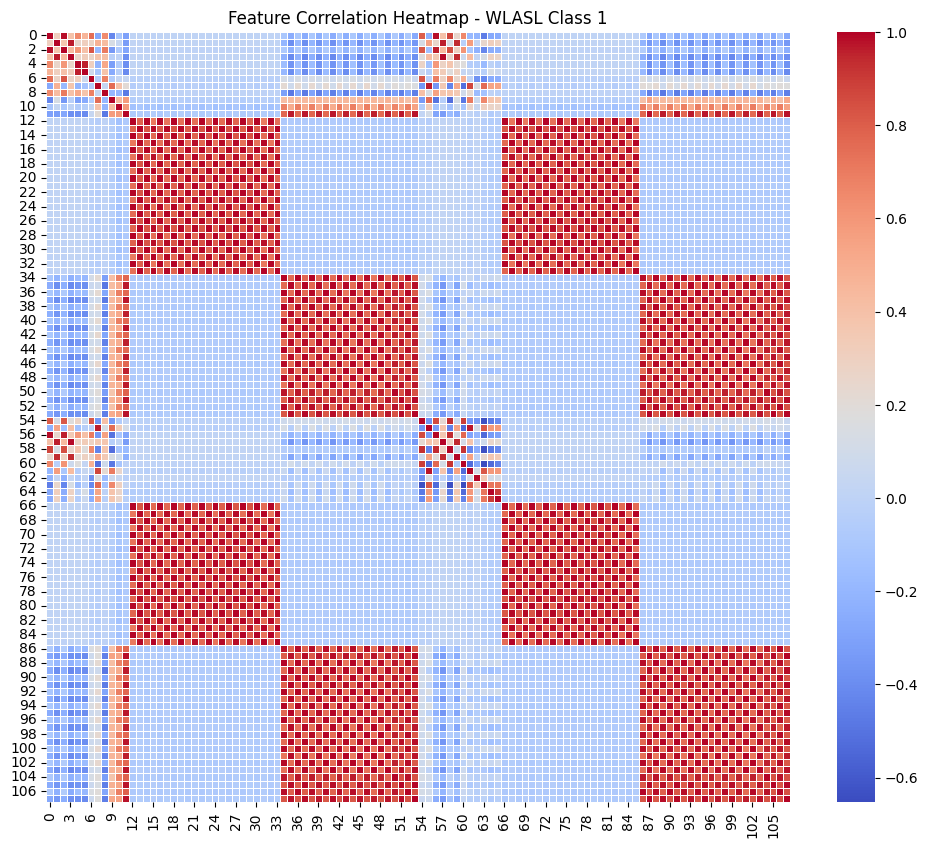

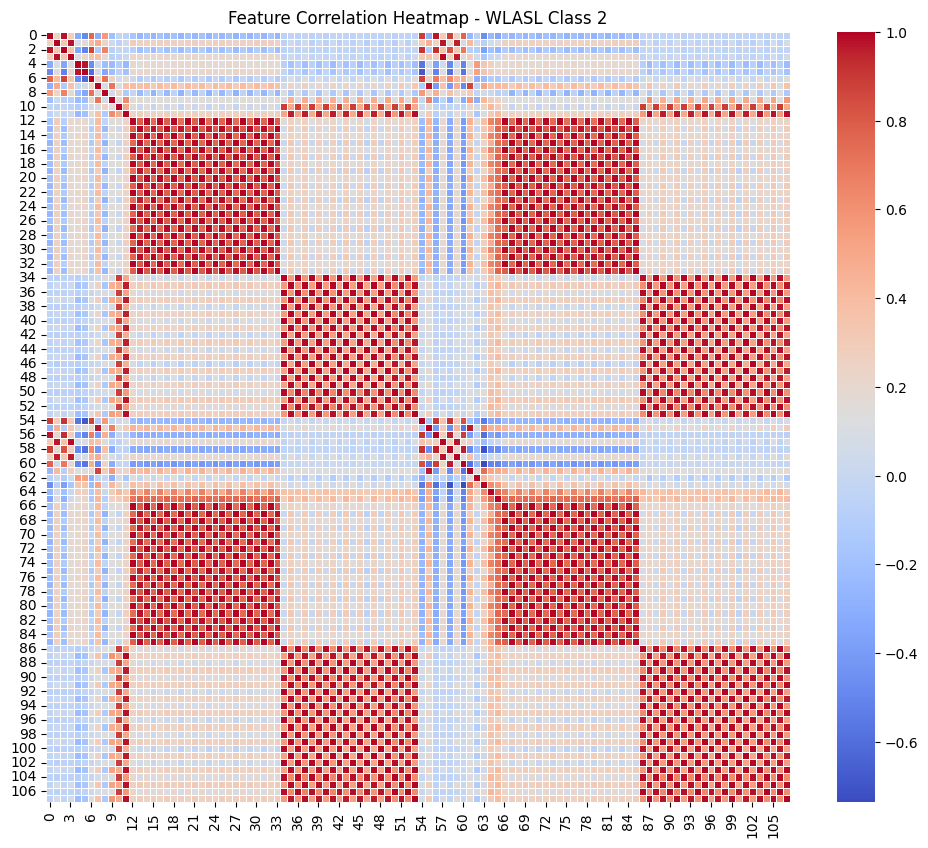

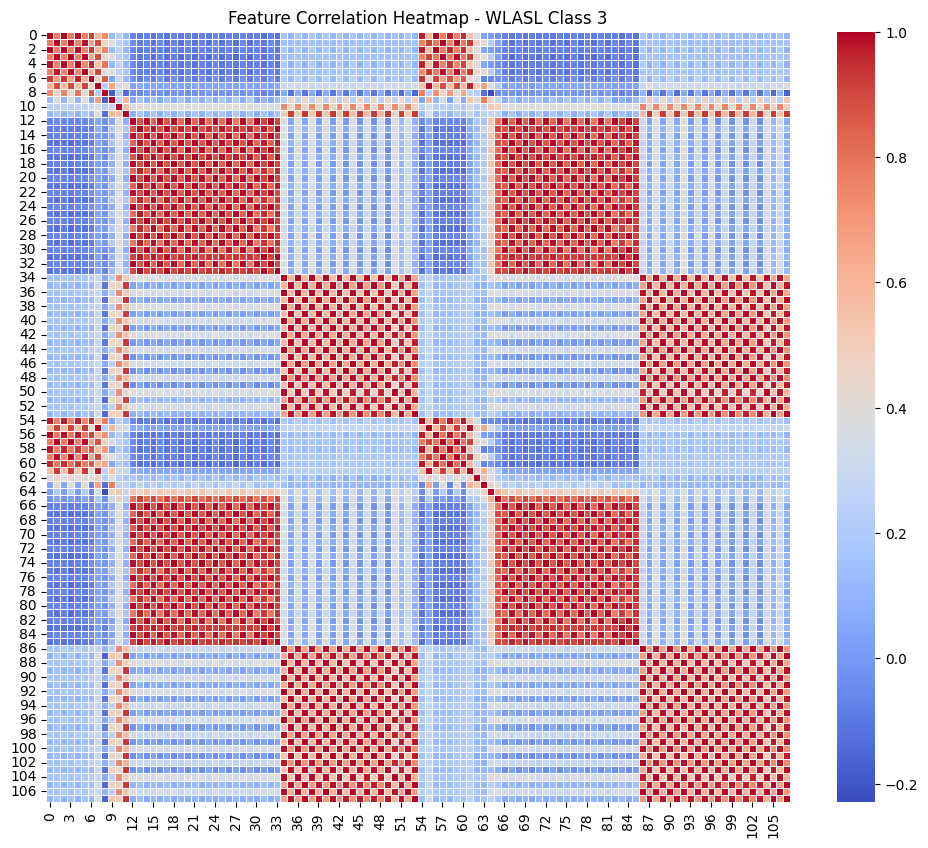

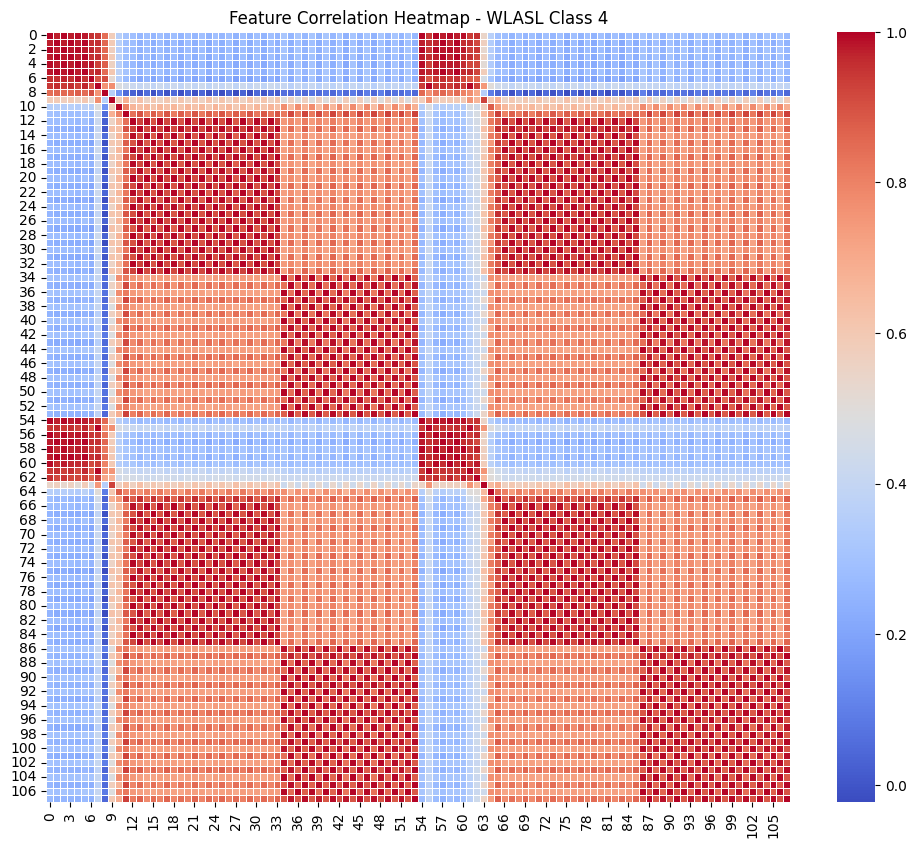

...

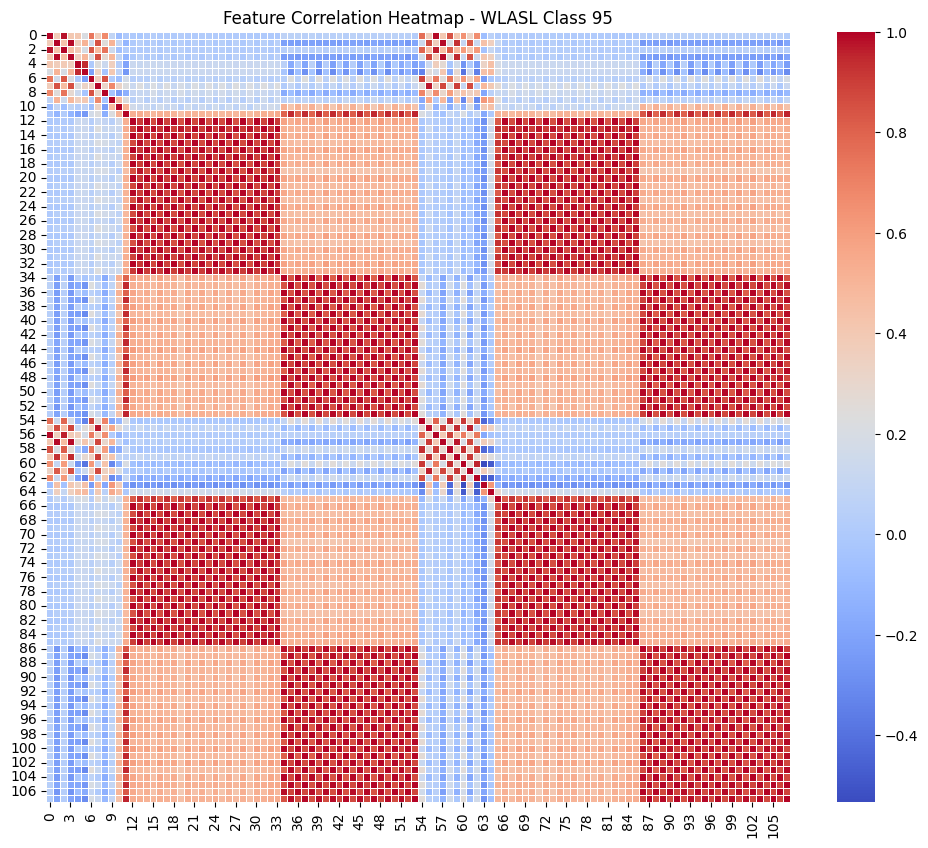

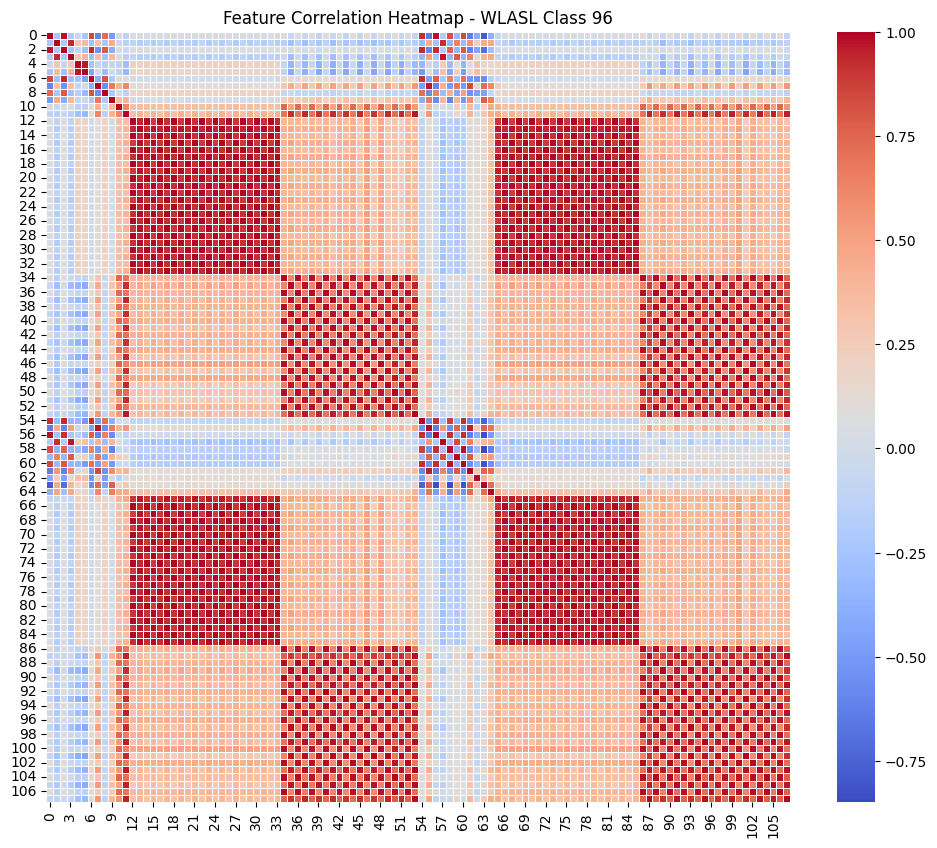

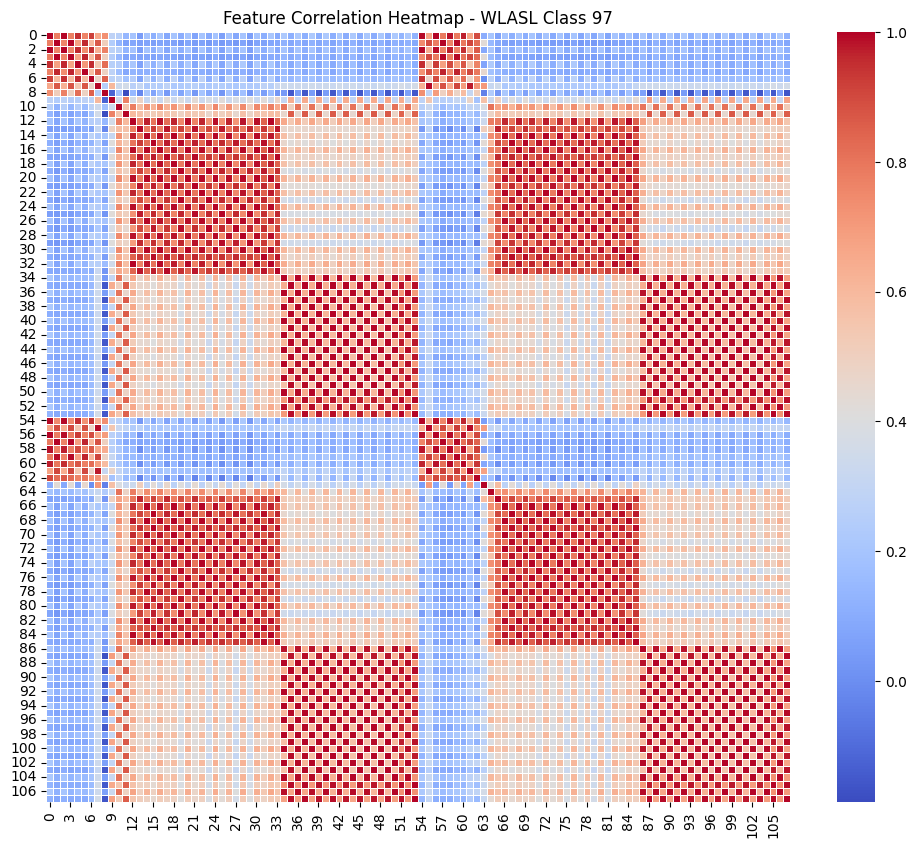

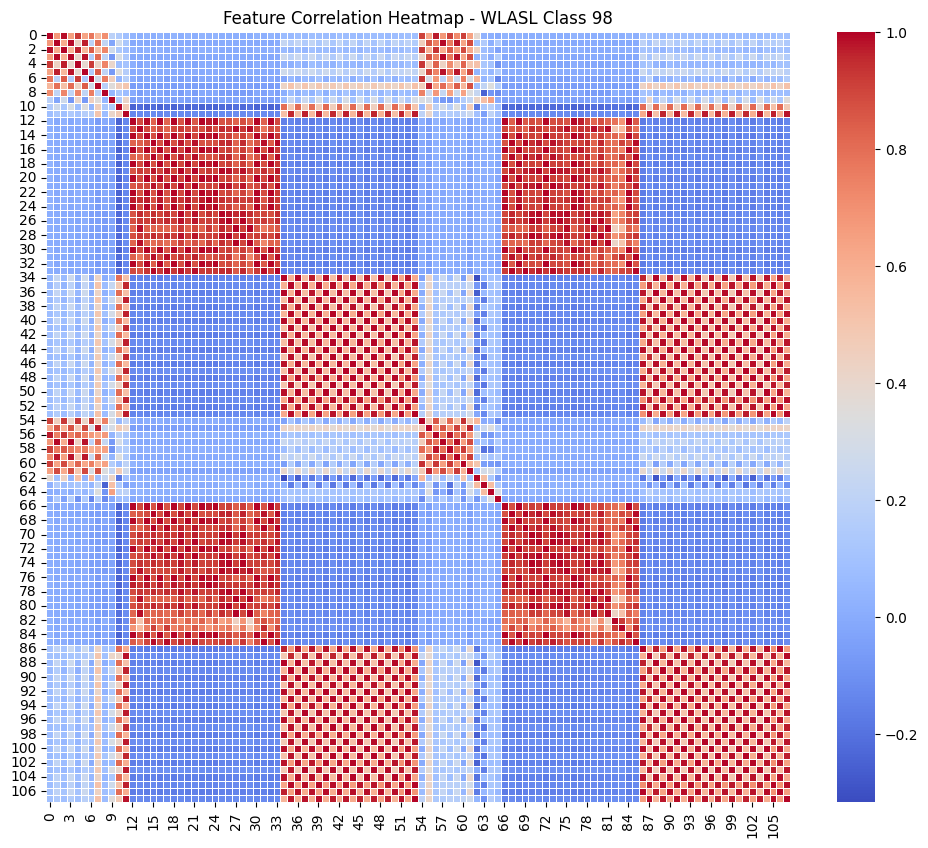

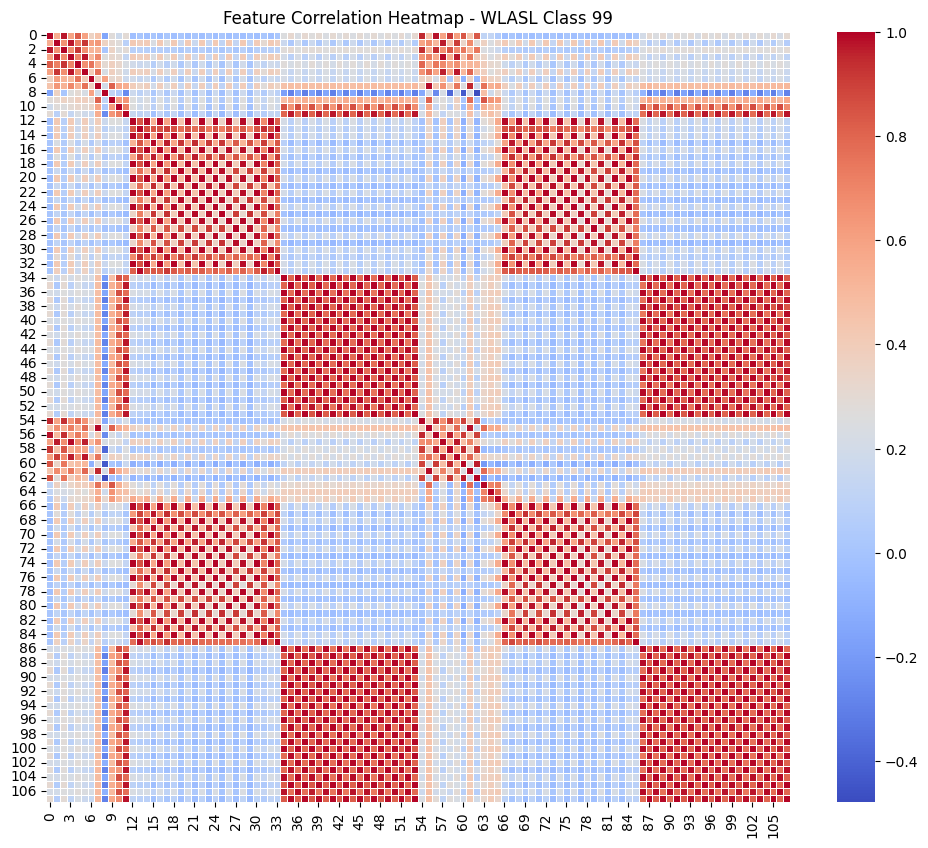

In [37]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

class_keypoints = {label: [] for label in set(WLASL_Train_labels)}

for i in range(len(WLASL_Train_labels)):
    label = WLASL_Train_labels[i]
    keypoints = WLASL_Train_data[i]
    class_keypoints[label].extend(keypoints)  

for label in class_keypoints:
    class_keypoints[label] = np.array(class_keypoints[label])

num_keypoints = 54

correlation_matrices = {label: np.corrcoef(class_keypoints[label][:, 0::2].reshape(-1, num_keypoints).T,
                                           class_keypoints[label][:, 1::2].reshape(-1, num_keypoints).T)
                        for label in class_keypoints}

for label in correlation_matrices:
    plt.figure(figsize=(12, 10))
    plt.title(f'Feature Correlation Heatmap - WLASL training portion - Class {label}')
    sns.heatmap(correlation_matrices[label], annot=False, cmap='coolwarm', fmt=".2f", linewidths=.5)
    plt.show()

# Data point 

In [4]:
import pandas as pd

csv_file_path = r"D:\Spoter_transformer_SLR\datasets\LSA64_60fps.csv"

df = pd.read_csv(csv_file_path)

column_names = df.columns

filtered_columns = [col for col in column_names if col.endswith(("X", "Y"))]
filtered_columns.remove("root_X")
filtered_columns.remove("root_Y")

for idx, col in enumerate(filtered_columns):
    print(f"{idx}: \"{col}\",")

0: "middlePIP_left_Y",
1: "littlePIP_right_Y",
2: "middleTip_right_Y",
3: "thumbIP_left_X",
4: "middleMCP_right_Y",
5: "indexMCP_right_X",
6: "middleTip_right_X",
7: "middlePIP_right_Y",
8: "rightElbow_X",
9: "indexTip_left_Y",
10: "thumbMP_right_Y",
11: "neck_X",
12: "wrist_right_Y",
13: "middleDIP_right_Y",
14: "ringDIP_left_Y",
15: "indexTip_right_X",
16: "indexPIP_right_Y",
17: "ringMCP_right_Y",
18: "rightShoulder_Y",
19: "littleDIP_left_Y",
20: "thumbCMC_right_Y",
21: "ringTip_right_X",
22: "thumbCMC_left_X",
23: "rightShoulder_X",
24: "littlePIP_left_X",
25: "thumbIP_left_Y",
26: "thumbTip_left_Y",
27: "littleTip_left_X",
28: "littleTip_right_Y",
29: "thumbCMC_left_Y",
30: "indexMCP_left_X",
31: "ringDIP_left_X",
32: "middleTip_left_X",
33: "ringPIP_left_Y",
34: "ringPIP_left_X",
35: "middleTip_left_Y",
36: "ringMCP_left_Y",
37: "littleDIP_right_Y",
38: "indexMCP_right_Y",
39: "wrist_right_X",
40: "middlePIP_left_X",
41: "littleMCP_left_X",
42: "leftEye_X",
43: "thumbIP_right_Y"

In [32]:
column_names = df.columns

grouped_columns = {}
for col in column_names:
    prefix = col.split("_")[0]
    if prefix != "root" and prefix != "video" and prefix != "labels":
        if prefix not in grouped_columns:
            grouped_columns[prefix] = []
        grouped_columns[prefix].append(col)
    
for prefix, columns in grouped_columns.items():
    print(f'Columns with prefix {prefix}:')
    for col in columns:
        idx = filtered_columns.index(col)
        print(f'{idx}: {col}')
    print()

Columns with prefix middlePIP:
0: middlePIP_left_Y
7: middlePIP_right_Y
40: middlePIP_left_X
61: middlePIP_right_X

Columns with prefix littlePIP:
1: littlePIP_right_Y
24: littlePIP_left_X
65: littlePIP_left_Y
99: littlePIP_right_X

Columns with prefix middleTip:
2: middleTip_right_Y
6: middleTip_right_X
32: middleTip_left_X
35: middleTip_left_Y

Columns with prefix thumbIP:
3: thumbIP_left_X
25: thumbIP_left_Y
43: thumbIP_right_Y
83: thumbIP_right_X

Columns with prefix middleMCP:
4: middleMCP_right_Y
51: middleMCP_right_X
73: middleMCP_left_X
96: middleMCP_left_Y

Columns with prefix indexMCP:
5: indexMCP_right_X
30: indexMCP_left_X
38: indexMCP_right_Y
70: indexMCP_left_Y

Columns with prefix rightElbow:
8: rightElbow_X
69: rightElbow_Y

Columns with prefix indexTip:
9: indexTip_left_Y
15: indexTip_right_X
53: indexTip_left_X
84: indexTip_right_Y

Columns with prefix thumbMP:
10: thumbMP_right_Y
44: thumbMP_right_X
67: thumbMP_left_X
75: thumbMP_left_Y

Columns with prefix neck:
11: